In [51]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import numpy as np
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.statespace.sarimax import SARIMAX
from itertools import product
from sklearn.metrics import mean_absolute_error, mean_squared_error
import warnings
from statsmodels.tsa.arima.model import ARIMA
import itertools
from prophet import Prophet
from statsmodels.tsa.holtwinters import ExponentialSmoothing

In [52]:
# Fill categorical missing values with 'Unknown'
df = pd.read_csv('cleaned_data_dropped.csv',low_memory=False)
categorical_cols = df.select_dtypes(include=['object']).columns
print(categorical_cols)

Index(['FACILITY NAME', 'ST', 'INDUSTRY SECTOR', 'CHEMICAL',
       'CLEAN AIR ACT CHEMICAL', 'CLASSIFICATION', 'METAL', 'METAL CATEGORY',
       'CARCINOGEN', 'PBT', 'PFAS', 'UNIT OF MEASURE'],
      dtype='object')


In [53]:
df.columns

Index(['YEAR', 'FACILITY NAME', 'ST', 'INDUSTRY SECTOR CODE',
       'INDUSTRY SECTOR', 'CHEMICAL', 'CLEAN AIR ACT CHEMICAL',
       'CLASSIFICATION', 'METAL', 'METAL CATEGORY', 'CARCINOGEN', 'PBT',
       'PFAS', 'UNIT OF MEASURE', 'FUGITIVE AIR', 'STACK AIR', 'WATER',
       'UNDERGROUND', 'LANDFILLS', 'LAND TREATMENT', 'SURFACE IMPNDMNT',
       'OTHER DISPOSAL', 'ON-SITE RELEASE TOTAL', 'POTW - TRNS RLSE',
       'POTW - TRNS TRT', 'POTW - TOTAL TRANSFERS', 'OFF-SITE RELEASE TOTAL',
       'OFF-SITE RECYCLED TOTAL', 'OFF-SITE ENERGY RECOVERY T',
       'OFF-SITE TREATED TOTAL', 'UNCLASSIFIED', 'TOTAL TRANSFER',
       'TOTAL RELEASES', 'RELEASES', 'ON-SITE CONTAINED', 'ON-SITE OTHER',
       'OFF-SITE CONTAIN', 'OFF-SITE OTHER RELEASES', 'ENERGY RECOVER ON',
       'ENERGY RECOVER OF', 'RECYCLING ON SITE', 'RECYCLING OFF SIT',
       'TREATMENT ON SITE', 'TREATMENT OFF SITE', 'PRODUCTION WASTE',
       'PRODUCTION RATIO'],
      dtype='object')

In [54]:
columns_to_combine = ['ENERGY RECOVER ON', 'ENERGY RECOVER OF', 'RECYCLING ON SITE',
                     'RECYCLING OFF SIT', 'TREATMENT ON SITE', 'TREATMENT OFF SITE']

df['TOTAL OTHER TREATMENT'] = df[columns_to_combine].sum(axis=1)

df = df.drop(columns=columns_to_combine, errors='ignore')

df.head()


,YEAR,FACILITY NAME,ST,INDUSTRY SECTOR CODE,INDUSTRY SECTOR,CHEMICAL,CLEAN AIR ACT CHEMICAL,CLASSIFICATION,METAL,METAL CATEGORY,...,TOTAL TRANSFER,TOTAL RELEASES,RELEASES,ON-SITE CONTAINED,ON-SITE OTHER,OFF-SITE CONTAIN,OFF-SITE OTHER RELEASES,PRODUCTION WASTE,PRODUCTION RATIO,TOTAL OTHER TREATMENT
0,2003,TILLEY DISTRIBUTION,MD,4246,Chemical Wholesalers,Dichloromethane,YES,TRI,NO,Non_Metal,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0
1,2003,UNITED FUEL & ENERGY CORP,TX,4247,Petroleum Bulk Terminals,Naphthalene,YES,TRI,NO,Non_Metal,...,0.0,54.0,0.0,0.0,54.0,0.0,0.0,54.0,0.00,0.0
2,2003,SOLENIS LLC,TX,325,Chemicals,Maleic anhydride,YES,TRI,NO,Non_Metal,...,124.0,717.0,0.0,0.0,717.0,0.0,0.0,841.0,0.41,124.0
3,2003,DFA DAIRY BRANDS FLUID LLC DBA PET DAIRY,SC,311,Food,Chlorodifluoromethane (HCFC-22),NO,TRI,NO,Non_Metal,...,0.0,13152.0,0.0,0.0,13152.0,0.0,0.0,13152.0,1.00,0.0
4,2003,AXALTA COATING SYSTEMS USA LLC-FRONT ROYAL PLANT,VA,325,Chemicals,Methyl methacrylate,YES,TRI,NO,Non_Metal,...,390.0,4280.0,0.0,0.0,4280.0,0.0,0.0,4670.0,1.30,390.0


In [55]:
# Aggregate by year (if not already aggregated)
time_series_data = df.groupby('YEAR')['TOTAL OTHER TREATMENT'].sum().reset_index()

# Ensure the YEAR column is a datetime type
time_series_data['YEAR'] = pd.to_datetime(time_series_data['YEAR'], format='%Y')
# Step 1: Check stationarity and transform if needed
time_series_data['TOTAL OTHER TREATMENT_DIFF'] = time_series_data['TOTAL OTHER TREATMENT'].diff().dropna()

# ADF test for stationarity
adf_test = adfuller(time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna())
print("ADF Statistic:", adf_test[0])
print("p-value:", adf_test[1])
outliers_detect = time_series_data.copy()
# Set YEAR as the index for time-series analysis
time_series_data.set_index('YEAR', inplace=True)

# Display the data
print(time_series_data.head())
print(time_series_data.columns)
print(outliers_detect.columns)

ADF Statistic: -3.907135833850076
p-value: 0.001982954431683732
            TOTAL OTHER TREATMENT  TOTAL OTHER TREATMENT_DIFF
YEAR                                                         
2003-01-01           2.082006e+10                         NaN
2004-01-01           2.150193e+10                6.818729e+08
2005-01-01           2.038164e+10               -1.120291e+09
2006-01-01           1.978378e+10               -5.978555e+08
2007-01-01           1.975672e+10               -2.705810e+07
Index(['TOTAL OTHER TREATMENT', 'TOTAL OTHER TREATMENT_DIFF'], dtype='object')
Index(['YEAR', 'TOTAL OTHER TREATMENT', 'TOTAL OTHER TREATMENT_DIFF'], dtype='object')


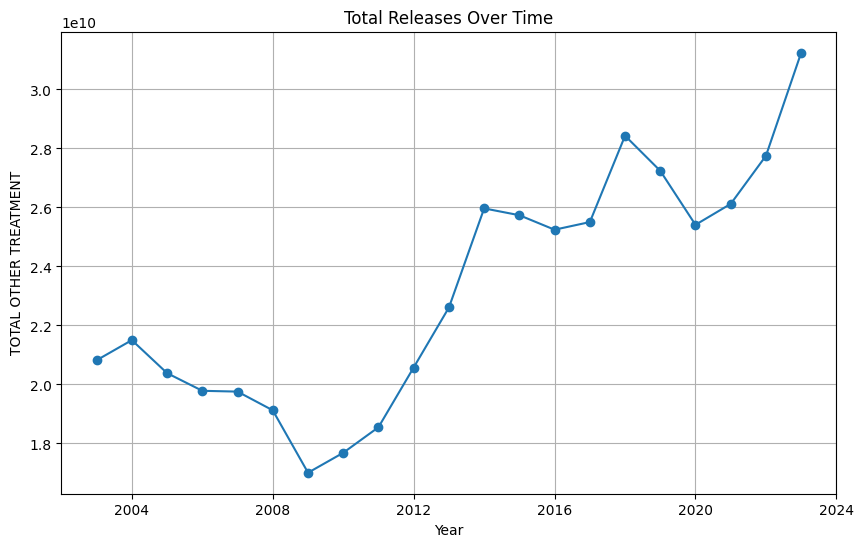

In [56]:
# Plot the time series
plt.figure(figsize=(10, 6))
plt.plot(time_series_data.index, time_series_data['TOTAL OTHER TREATMENT'], marker='o')
plt.title('Total Releases Over Time')
plt.xlabel('Year')
plt.ylabel('TOTAL OTHER TREATMENT')
plt.grid()
plt.show()


In [57]:
# Calculate IQR
Q1 = time_series_data['TOTAL OTHER TREATMENT'].quantile(0.25)
Q3 = time_series_data['TOTAL OTHER TREATMENT'].quantile(0.75)
IQR = Q3 - Q1

# Identify outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR
outliers = time_series_data[(time_series_data['TOTAL OTHER TREATMENT'] < lower_bound) | 
                            (time_series_data['TOTAL OTHER TREATMENT'] > upper_bound)]
print("Q1", Q1)
print("Q3", Q3)
print("IQR", IQR)
# print(time_series_data['TOTAL OTHER TREATMENT'])
print("Outliers based on IQR:")
print(outliers)


Q1 19783782644.26065
Q3 25968070932.08196
IQR 6184288287.821308
Outliers based on IQR:
Empty DataFrame
Columns: [TOTAL OTHER TREATMENT, TOTAL OTHER TREATMENT_DIFF]
Index: []


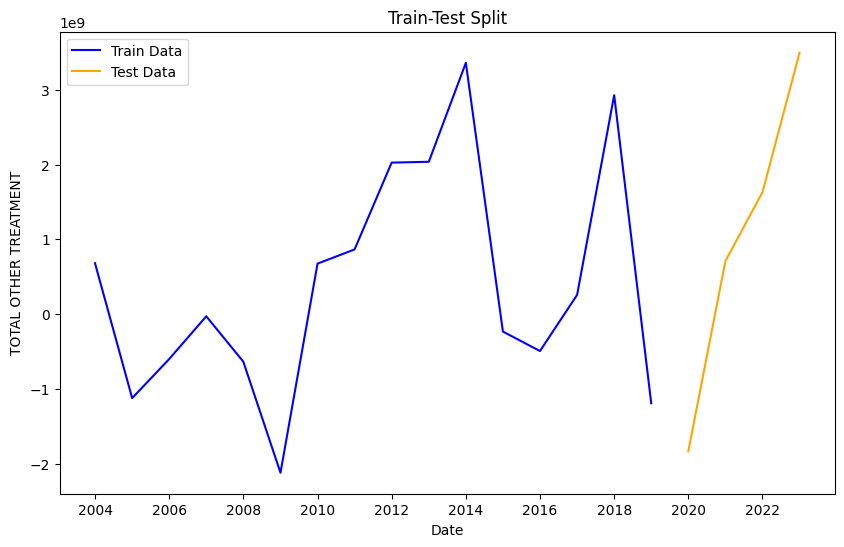

In [58]:
# Define split ratio (e.g., 80% train, 20% test)
split_ratio = 0.8
split_index = int(len(time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna()) * split_ratio)

# Split into train and test
train_data = time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna()[:split_index]
test_data = time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna()[split_index:]

# Define test_start and test_end
test_start = test_data.index[0]
test_end = test_data.index[-1]
# Extract actual values from the time series data for the test period
actual_values = time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna()[test_start:test_end]

plt.figure(figsize=(10, 6))
plt.plot(train_data, label='Train Data', color='blue')
plt.plot(test_data, label='Test Data', color='orange')
plt.xlabel('Date')
plt.ylabel('TOTAL OTHER TREATMENT')
plt.title('Train-Test Split')
plt.legend()
plt.show()


In [59]:
def error_percentage(y_true, y_pred):
    """
    Calculate the error percentage using NumPy.

    Parameters:
    y_true (array-like): Actual values
    y_pred (array-like): Predicted values

    Returns:
    float: Error percentage
    """
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    errors = np.abs((y_true - y_pred) / y_true)
    return np.mean(errors) * 100

In [60]:

warnings.filterwarnings('ignore')

# Define parameter grid for SARIMA
p = d = q = range(0, 3)  # Non-seasonal params
P = D = Q = range(0, 2)  # Seasonal params
s = [12]  # Seasonal period (yearly data)

# Create all combinations
param_grid = list(product(p, d, q, P, D, Q, s))

# Track best parameters
best_rmse_SARIMA = float("inf")
best_maep_SARIMA = float("inf")
best_params = None

# Grid search
for params in param_grid:
    try:
        sarima_model = SARIMAX(time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna()[:-4],
                               order=(params[0], params[1], params[2]),
                               seasonal_order=(params[3], params[4], params[5], params[6]),
                               enforce_stationarity=False,
                               enforce_invertibility=False)
        results = sarima_model.fit(disp=False)
        # Predict and evaluate
        predictions = results.predict(start=test_start, end=test_end)
        rmse = np.sqrt(mean_squared_error(actual_values, predictions))
        maep = error_percentage(actual_values, predictions)
        if rmse < best_rmse_SARIMA:
            best_rmse_SARIMA = rmse
            best_params = params
            best_maep_SARIMA = maep
    except Exception as e:
        continue

p, d, q, P, D, Q, s = best_params
print(f'Best SARIMA Parameters: {best_params}')
print(f'Best RMSE: {best_rmse_SARIMA}')
print(f'Best MAEP: {best_maep_SARIMA}')


Best SARIMA Parameters: (0, 2, 1, 0, 0, 1, 12)
Best RMSE: 894241612.7588094
Best MAEP: 35.38758905749021


In [61]:
# Refit the model using the best parameters
best_model = SARIMAX(
    time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna(), 
    order=(p, d, q),        # (p, d, q)
    seasonal_order=(P, D, Q, s),  # (P, D, Q, s)
    enforce_stationarity=False, 
    enforce_invertibility=False
)

best_model_fitted = best_model.fit(disp=False)
print(best_model_fitted.summary())

# Predict on the test set
predicted_values = best_model_fitted.predict(start=test_start, end=test_end)
rmse = np.sqrt(mean_squared_error(actual_values, predicted_values))
print(f"Test RMSE: {rmse}")
print(actual_values)
print(predicted_values)



                                     SARIMAX Results                                      
Dep. Variable:         TOTAL OTHER TREATMENT_DIFF   No. Observations:                   20
Model:             SARIMAX(0, 2, 1)x(0, 0, 1, 12)   Log Likelihood                 -90.236
Date:                            Wed, 20 Nov 2024   AIC                            186.471
Time:                                    19:57:37   BIC                            184.630
Sample:                                01-01-2004   HQIC                           182.431
                                     - 01-01-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -1.0552      0.367     -2.878      0.004      -1.774      -0.337
ma.S.L12      -0.1428      4.976   

2024-01-01    4.572648e+09
2025-01-01    5.816305e+09
2026-01-01    6.872741e+09
2027-01-01    8.630697e+09
2028-01-01    9.913088e+09
Name: predicted_mean, dtype: float64
                 YEAR      FORECAST
2024-01-01 2024-12-31  4.572648e+09
2025-01-01 2025-12-31  5.816305e+09
2026-01-01 2026-12-31  6.872741e+09
2027-01-01 2027-12-31  8.630697e+09
2028-01-01 2028-12-31  9.913088e+09


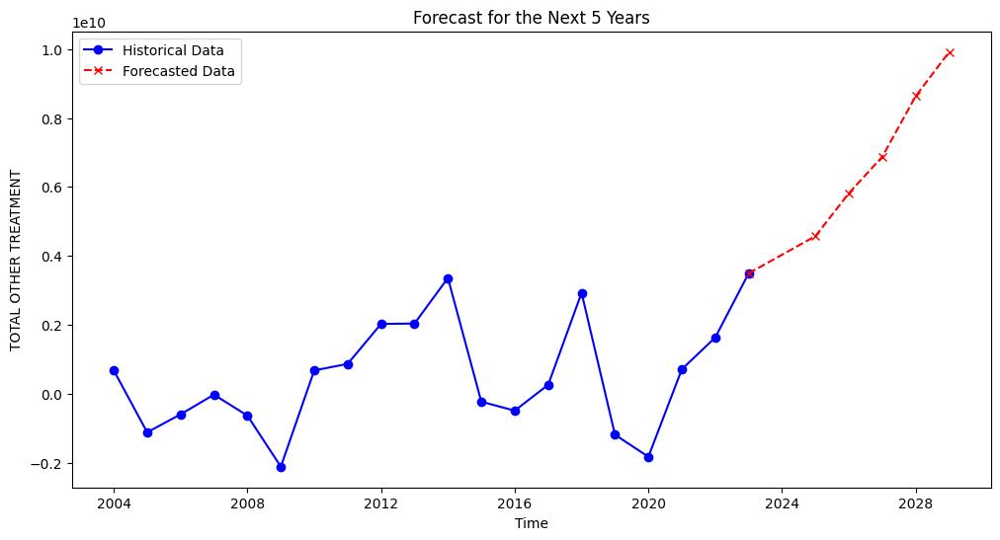

In [62]:
# Forecast for the next 5 years (60 months)
forecast_steps = 5 * 12  # 5 years
forecast = best_model_fitted.forecast(steps=forecast_steps)

# Create a date range for the forecast
forecast_index = pd.date_range(start='2024-01-01', periods=forecast_steps, freq='MS')
forecast_series = pd.Series(forecast, index=forecast_index)
forecast_series = forecast_series.dropna()
# Print the forecasted values
print(forecast_series)
historical_df = time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna().reset_index()
historical_df.columns = ['YEAR', 'ACTUAL']
# Display forecasted values
future_years = pd.date_range(start=time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna().index[-1] + pd.DateOffset(years=1), periods=5, freq='Y')
forecast_df = pd.DataFrame({'YEAR': future_years, 'FORECAST': forecast_series})
print(forecast_df)

plt.figure(figsize=(12, 6))
# Plot historical data
plt.plot(historical_df['YEAR'], historical_df['ACTUAL'], label='Historical Data', marker='o', color='blue')
# Plot forecasted data
plt.plot([historical_df['YEAR'].iloc[-1]] + forecast_df['YEAR'].tolist(), 
         [historical_df['ACTUAL'].iloc[-1]] + forecast_df['FORECAST'].tolist(), 
         label='Forecasted Data', marker='x', linestyle='--', color='red')
plt.title('Forecast for the Next 5 Years')
plt.xlabel('Time')
plt.ylabel('TOTAL OTHER TREATMENT')
plt.legend()
plt.show()


In [63]:
# Inverse the differencing to return to the original scale
last_value = time_series_data['TOTAL OTHER TREATMENT'].iloc[-1]
forecast_original_scale = forecast_series.cumsum() + last_value  
forecast_original_scale

2024-01-01    3.581873e+10
2025-01-01    4.163503e+10
2026-01-01    4.850777e+10
2027-01-01    5.713847e+10
2028-01-01    6.705156e+10
Name: predicted_mean, dtype: float64

                 YEAR      FORECAST
2024-01-01 2024-12-31  3.581873e+10
2025-01-01 2025-12-31  4.163503e+10
2026-01-01 2026-12-31  4.850777e+10
2027-01-01 2027-12-31  5.713847e+10
2028-01-01 2028-12-31  6.705156e+10


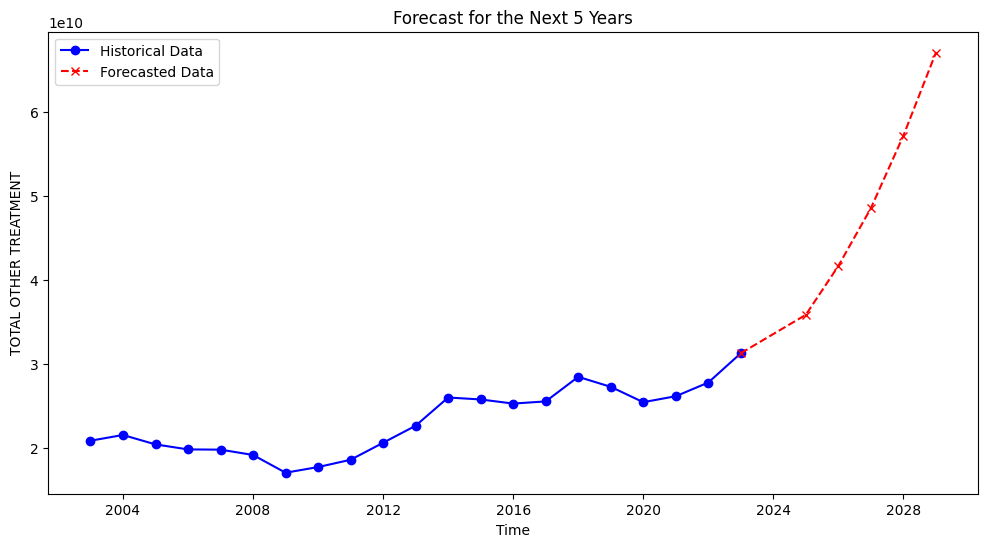

In [64]:
historical_df = time_series_data['TOTAL OTHER TREATMENT'].dropna().reset_index()
historical_df.columns = ['YEAR', 'ACTUAL']
# Display forecasted values
future_years = pd.date_range(start=time_series_data['TOTAL OTHER TREATMENT'].dropna().index[-1] + pd.DateOffset(years=1), periods=5, freq='Y')
forecast_df = pd.DataFrame({'YEAR': future_years, 'FORECAST': forecast_original_scale})
print(forecast_df)

plt.figure(figsize=(12, 6))
# Plot historical data
plt.plot(historical_df['YEAR'], historical_df['ACTUAL'], label='Historical Data', marker='o', color='blue')

# Plot forecasted data
plt.plot([historical_df['YEAR'].iloc[-1]] + forecast_df['YEAR'].tolist(), 
         [historical_df['ACTUAL'].iloc[-1]] + forecast_df['FORECAST'].tolist(), 
         label='Forecasted Data', marker='x', linestyle='--', color='red')

plt.title('Forecast for the Next 5 Years')
plt.xlabel('Time')
plt.ylabel('TOTAL OTHER TREATMENT')
plt.legend()
plt.show()

In [65]:

# Define the p, d, q parameter ranges
p = d = q = range(0, 3)
pdq = list(itertools.product(p, d, q))

best_aic = float('inf')
best_pdq = None

for param in pdq:
    try:
        model = ARIMA(time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna(), order=param)
        model_fit = model.fit()
        if model_fit.aic < best_aic:
            best_aic = model_fit.aic
            best_pdq = param
    except:
        continue

print(f"Best ARIMA model order: {best_pdq} with AIC: {best_aic}")


Best ARIMA model order: (0, 2, 1) with AIC: 826.2212883684384


In [66]:
# Define the parameter grid for ARIMA (p, d, q)
p = d = q = range(0, 3)
pdq = list(itertools.product(p, d, q))

best_rmse_ARIMA = float('inf')
best_pdq = None

for param in pdq:
    try:
        model = ARIMA(time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna()[:-4], order=param)
        model_fit = model.fit()

        # Predict on the train set (or test set if available)
        predicted_values = model_fit.predict(start=test_start, end=test_end)

        # Calculate RMSE
        rmse = np.sqrt(mean_squared_error(actual_values, predicted_values))
        # print(rmse)
        # Update best model if RMSE is better
        if rmse < best_rmse_ARIMA:
            best_rmse_ARIMA = rmse
            best_pdq = param
    except Exception as e:
        print(f"Error with parameters {param}: {e}")
        continue

print(f"Best ARIMA model order: {best_pdq} with RMSE: {best_rmse_ARIMA}")


Best ARIMA model order: (2, 0, 2) with RMSE: 1797692056.4582946


In [67]:
# Fit the model with the best parameters
best_model = ARIMA(time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna(), order=best_pdq)
best_model_fit = best_model.fit()

# Print the model summary
print(best_model_fit.summary())


                                   SARIMAX Results                                    
Dep. Variable:     TOTAL OTHER TREATMENT_DIFF   No. Observations:                   20
Model:                         ARIMA(2, 0, 2)   Log Likelihood                -450.019
Date:                        Wed, 20 Nov 2024   AIC                            912.038
Time:                                19:57:43   BIC                            918.013
Sample:                            01-01-2004   HQIC                           913.205
                                 - 01-01-2023                                         
Covariance Type:                          opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       5.213e+08   1.78e-10   2.94e+18      0.000    5.21e+08    5.21e+08
ar.L1         -0.4802      0.547     -0.877      0.380      -1.553 

2024-01-01    1.017505e+09
2025-01-01    1.074714e+09
2026-01-01   -2.222625e+07
2027-01-01    4.724756e+08
2028-01-01    8.490287e+08
Freq: YS-JAN, Name: predicted_mean, dtype: float64
                 YEAR      FORECAST
2024-01-01 2024-12-31  1.017505e+09
2025-01-01 2025-12-31  1.074714e+09
2026-01-01 2026-12-31 -2.222625e+07
2027-01-01 2027-12-31  4.724756e+08
2028-01-01 2028-12-31  8.490287e+08


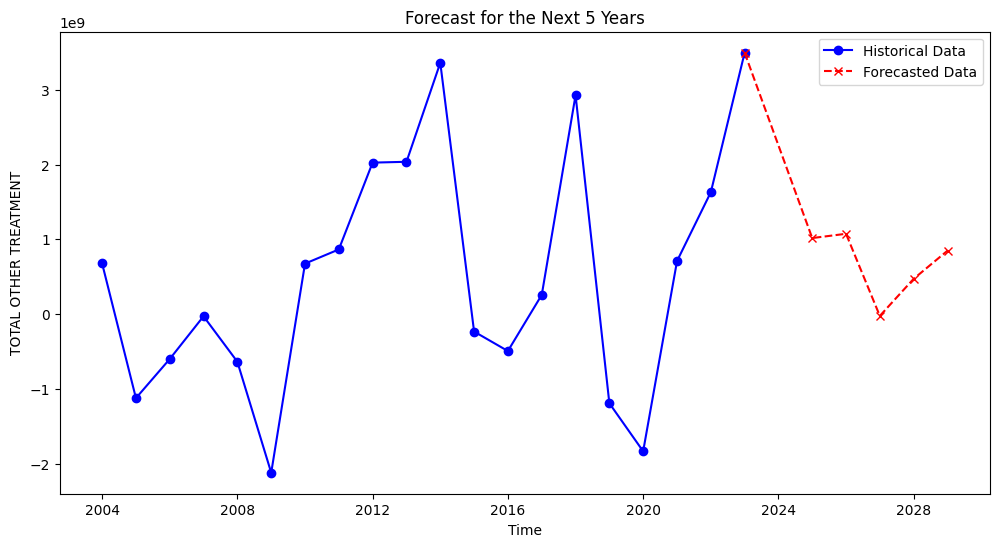

In [68]:
# Fit the ARIMA model with the best parameters (best_pdq)
model = ARIMA(time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna(), order=best_pdq)  # Use the best (p, d, q) found during tuning
model_fit = model.fit()

forecast = model_fit.forecast(steps=5)
print(forecast)

historical_df = time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna().reset_index()
historical_df.columns = ['YEAR', 'ACTUAL']
# Display forecasted values
future_years = pd.date_range(start=time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna().index[-1] + pd.DateOffset(years=1), periods=5, freq='Y')
forecast_df = pd.DataFrame({'YEAR': future_years, 'FORECAST': forecast})
print(forecast_df)
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))


# Plot historical data
plt.plot(historical_df['YEAR'], historical_df['ACTUAL'], label='Historical Data', marker='o', color='blue')

# Plot forecasted data
plt.plot([historical_df['YEAR'].iloc[-1]] + forecast_df['YEAR'].tolist(), 
         [historical_df['ACTUAL'].iloc[-1]] + forecast_df['FORECAST'].tolist(), 
         label='Forecasted Data', marker='x', linestyle='--', color='red')

plt.title('Forecast for the Next 5 Years')
plt.xlabel('Time')
plt.ylabel('TOTAL OTHER TREATMENT')
plt.legend()
plt.show()


In [69]:
# Inverse the differencing to return to the original scale
last_value = time_series_data['TOTAL OTHER TREATMENT'].iloc[-1]
forecast_original_scale = forecast.cumsum() + last_value
forecast_original_scale

2024-01-01    3.226358e+10
2025-01-01    3.333830e+10
2026-01-01    3.331607e+10
2027-01-01    3.378855e+10
2028-01-01    3.463758e+10
Freq: YS-JAN, Name: predicted_mean, dtype: float64

                 YEAR      FORECAST
2024-01-01 2024-12-31  3.226358e+10
2025-01-01 2025-12-31  3.333830e+10
2026-01-01 2026-12-31  3.331607e+10
2027-01-01 2027-12-31  3.378855e+10
2028-01-01 2028-12-31  3.463758e+10


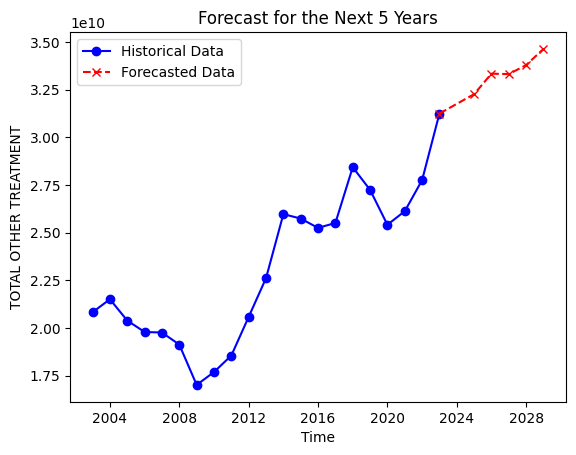

In [70]:
historical_df = time_series_data['TOTAL OTHER TREATMENT'].dropna().reset_index()
historical_df.columns = ['YEAR', 'ACTUAL']
# Display forecasted values
future_years = pd.date_range(start=time_series_data['TOTAL OTHER TREATMENT'].dropna().index[-1] + pd.DateOffset(years=1), periods=5, freq='Y')
forecast_df = pd.DataFrame({'YEAR': future_years, 'FORECAST': forecast_original_scale})
print(forecast_df)
# Plot historical data
plt.plot(historical_df['YEAR'], historical_df['ACTUAL'], label='Historical Data', marker='o', color='blue')

# Plot forecasted data
plt.plot([historical_df['YEAR'].iloc[-1]] + forecast_df['YEAR'].tolist(), 
         [historical_df['ACTUAL'].iloc[-1]] + forecast_df['FORECAST'].tolist(), 
         label='Forecasted Data', marker='x', linestyle='--', color='red')

plt.title('Forecast for the Next 5 Years')
plt.xlabel('Time')
plt.ylabel('TOTAL OTHER TREATMENT')
plt.legend()
plt.show()

In [71]:
# Rename columns for Prophet
prophet_data = outliers_detect.rename(columns={'YEAR': 'ds', 'TOTAL OTHER TREATMENT': 'y'})
# Fit the model
model = Prophet()
model.fit(prophet_data)

# Generate predictions
forecast = model.predict(prophet_data)

# Residuals
prophet_data['residuals'] = prophet_data['y'] - forecast['yhat']

# Highlight outliers
outliers = prophet_data[prophet_data['residuals'].abs() > 3 * prophet_data['residuals'].std()]
print("Outliers detected by Prophet:")
print(outliers)
 

19:57:44 - cmdstanpy - INFO - Chain [1] start processing
19:57:44 - cmdstanpy - INFO - Chain [1] done processing


Outliers detected by Prophet:
Empty DataFrame
Columns: [ds, y, TOTAL OTHER TREATMENT_DIFF, residuals]
Index: []


In [72]:
# Hyperparameter tuning for Prophet
best_rmse_prophet = float('inf')
best_prophet_params = None

# Hyperparameters for Prophet
changepoint_scales = [0.01, 0.1, 0.5]
seasonality_modes = ['additive', 'multiplicative']

# Assuming you have your time_series_data with 'TOTAL OTHER TREATMENT'
# and you are working with the original time series (not differenced)
df_prophet = time_series_data[['TOTAL OTHER TREATMENT_DIFF']].reset_index()
df_prophet.columns = ['ds', 'y']
# print(df_prophet[:-5])

for changepoint in changepoint_scales:
    for seasonality in seasonality_modes:
        try:
            # Create and fit the Prophet model
            model = Prophet(yearly_seasonality=True,changepoint_prior_scale=changepoint, seasonality_mode=seasonality)
            model.fit(df_prophet[:-5])

            # Forecast for the next 5 years (60 months)
            future = model.make_future_dataframe(periods=6, freq='Y',include_history=False)  # Forecasting for the next 5 years
            forecast = model.predict(future)
            # print(forecast_values)
            # Forecasted values
            forecast_values = forecast['yhat'][1:].values  # For the next 60 months
            print(forecast_values)

            # Compare with actual values (if available, for RMSE calculation)
            # You would compare these forecasted values with your test set if available
            # If no actual future values exist, this step can be skipped
            # Example assuming actual values for comparison (otherwise, remove this part):
            actual_values = time_series_data['TOTAL OTHER TREATMENT_DIFF'][-5:]  # Adjust this as needed
            # print("--------------",(actual_values, forecast_values))
            rmse = np.sqrt(mean_squared_error(actual_values, forecast_values))
            # print("--------------")

            # Update best RMSE and parameters
            if rmse < best_rmse_prophet:
                best_rmse_prophet = rmse
                best_prophet_params = (changepoint, seasonality)

        except Exception as e:
            print(f"Error with Prophet params (changepoint={changepoint}, seasonality={seasonality}): {e}")
            continue

print(f"Best Prophet model with RMSE: {best_rmse_prophet} and parameters: {best_prophet_params}")


19:57:44 - cmdstanpy - INFO - Chain [1] start processing
19:57:44 - cmdstanpy - INFO - Chain [1] done processing
19:57:44 - cmdstanpy - INFO - Chain [1] start processing
19:57:44 - cmdstanpy - INFO - Chain [1] done processing


[2.57624949e+09 2.45207598e+09 2.72025194e+09 2.98121105e+09
 3.23485263e+09]


19:57:44 - cmdstanpy - INFO - Chain [1] start processing


[-2.92453155e+09 -3.72479033e+08 -1.42460419e+09 -2.63422446e+09
 -3.99970456e+09]


19:57:45 - cmdstanpy - INFO - Chain [1] done processing
19:57:45 - cmdstanpy - INFO - Chain [1] start processing


[2.57626801e+09 2.45211239e+09 2.72028311e+09 2.98123625e+09
 3.23487114e+09]


19:57:45 - cmdstanpy - INFO - Chain [1] done processing
19:57:45 - cmdstanpy - INFO - Chain [1] start processing
19:57:45 - cmdstanpy - INFO - Chain [1] done processing


[-2.94036795e+09 -3.82813557e+08 -1.43844184e+09 -2.65229614e+09
 -4.02276954e+09]


19:57:45 - cmdstanpy - INFO - Chain [1] start processing
19:57:45 - cmdstanpy - INFO - Chain [1] done processing


[2.57626258e+09 2.45210044e+09 2.72027307e+09 2.98122839e+09
 3.23486570e+09]
[-2.96487958e+09 -3.89296776e+08 -1.45260415e+09 -2.67552109e+09
 -4.05648425e+09]
Best Prophet model with RMSE: 2772841756.0272026 and parameters: (0.01, 'additive')


19:57:45 - cmdstanpy - INFO - Chain [1] start processing
19:57:46 - cmdstanpy - INFO - Chain [1] done processing


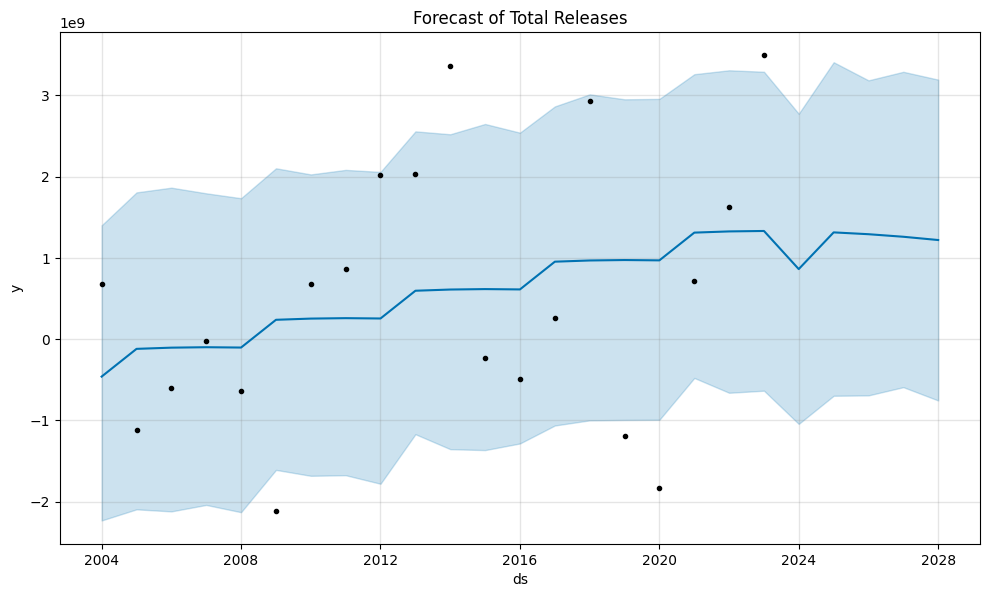

,ds,yhat,yhat_lower,yhat_upper
20,2023-12-31,8.629903e+08,-1.042494e+09,2.775444e+09
21,2024-12-31,1.314781e+09,-6.963227e+08,3.409181e+09
22,2025-12-31,1.292342e+09,-6.916353e+08,3.186156e+09
23,2026-12-31,1.260921e+09,-5.903763e+08,3.291384e+09
24,2027-12-31,1.220686e+09,-7.541894e+08,3.195326e+09


In [73]:
time_series_prophet_data = time_series_data['TOTAL OTHER TREATMENT_DIFF'].dropna().copy()
# Prepare data for Prophet
prophet_data = time_series_prophet_data.reset_index()
prophet_data.columns = ['ds', 'y']  # Prophet requires 'ds' for date and 'y' for the target

# Initialize and fit the Prophet model
model = Prophet(changepoint_prior_scale=best_prophet_params[0], seasonality_mode=best_prophet_params[1],yearly_seasonality=True)
model.fit(prophet_data)

# Create a DataFrame for future years
future = model.make_future_dataframe(periods=5, freq='Y')  # Forecasting for the next 5 years
forecast = model.predict(future)

# Plot the forecast
model.plot(forecast)
plt.title('Forecast of Total Releases')
plt.show()

# Display forecasted values
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail(5)


In [74]:
# Assuming 'time_series_data' has 'TOTAL OTHER TREATMENT' column with yearly data
df_hw = time_series_data[['TOTAL OTHER TREATMENT']][:-5]
trend_options = ['add', 'mul']
# Try fitting with no seasonality and additive seasonality
best_rmse_hw = float('inf')
best_hw_params = None

for trend in trend_options:
    for seasonal in [None, 'mul','add']:  # 'None' means no seasonality, 'add' means additive seasonality
        try:
            # Fit the Holt-Winters Exponential Smoothing model
            if seasonal:
                model = ExponentialSmoothing(df_hw, trend=trend, seasonal=seasonal,seasonal_periods=1)  # Yearly data, seasonal periods=1
            else:
                model = ExponentialSmoothing(df_hw, trend=trend, seasonal=None)  # No seasonality
            
            model_fit = model.fit()

            # Forecast for the next 5 years (5 values)
            forecast_steps = 5  # Forecasting 5 years ahead
            forecast_values = model_fit.forecast(forecast_steps)
            # print(forecast_values)
            # If actual future values are available, calculate RMSE
            # Assuming actual values exist in the future for comparison
            actual_values = time_series_data['TOTAL OTHER TREATMENT'].values[-5:]  # Adjust this if you have real data
            rmse = np.sqrt(mean_squared_error(actual_values, forecast_values))

            # Update best RMSE and parameters
            if rmse < best_rmse_hw:
                best_rmse_hw = rmse
                best_hw_params = (trend, seasonal)

        except Exception as e:
            print(f"Error with Exponential Smoothing params (seasonal={seasonal}): {e}")
            continue

print(f"Best Holt-Winters model with RMSE: {best_rmse_hw} and parameters: {best_hw_params}")


Error with Exponential Smoothing params (seasonal=mul): seasonal_periods must be larger than 1.
Error with Exponential Smoothing params (seasonal=add): seasonal_periods must be larger than 1.
Error with Exponential Smoothing params (seasonal=mul): seasonal_periods must be larger than 1.
Error with Exponential Smoothing params (seasonal=add): seasonal_periods must be larger than 1.
Best Holt-Winters model with RMSE: 4588706306.865808 and parameters: ('add', None)


In [75]:
# Fit Holt-Winters model (using additive trend and seasonality)
model = ExponentialSmoothing(time_series_data['TOTAL OTHER TREATMENT'], trend=best_hw_params[0], seasonal=best_hw_params[1]).fit()

# Forecast the next 12 periods (e.g., months)
forecast = model.forecast(steps=5)
print(forecast)

2024-01-01    3.211769e+10
2025-01-01    3.300452e+10
2026-01-01    3.389135e+10
2027-01-01    3.477818e+10
2028-01-01    3.566500e+10
Freq: YS-JAN, dtype: float64


                 YEAR      FORECAST
2024-01-01 2024-12-31  3.211769e+10
2025-01-01 2025-12-31  3.300452e+10
2026-01-01 2026-12-31  3.389135e+10
2027-01-01 2027-12-31  3.477818e+10
2028-01-01 2028-12-31  3.566500e+10


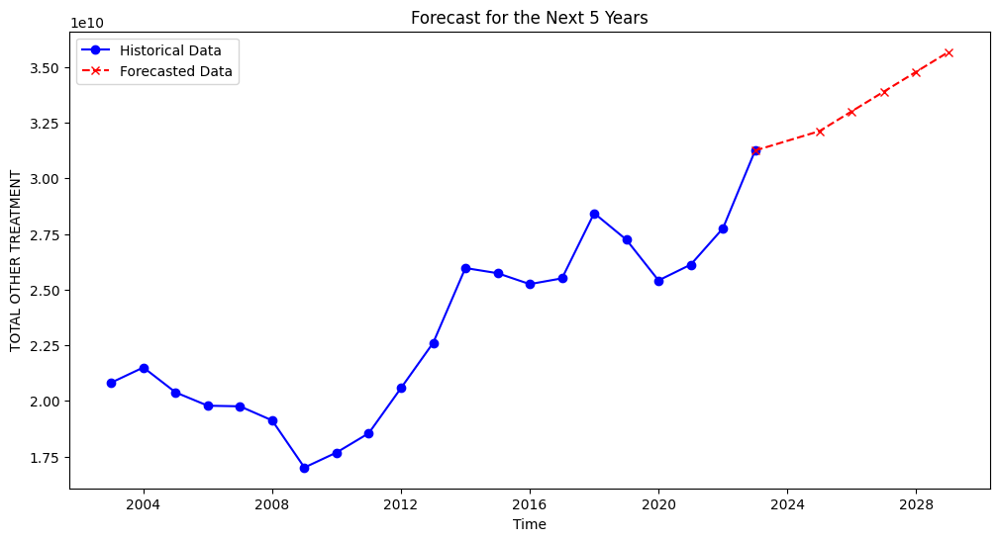

In [76]:
historical_df = time_series_data['TOTAL OTHER TREATMENT'].dropna().reset_index()
historical_df.columns = ['YEAR', 'ACTUAL']
# Display forecasted values
future_years = pd.date_range(start=time_series_data['TOTAL OTHER TREATMENT'].dropna().index[-1] + pd.DateOffset(years=1), periods=5, freq='Y')
forecast_df = pd.DataFrame({'YEAR': future_years, 'FORECAST': forecast})
print(forecast_df)
plt.figure(figsize=(12, 6))

# Plot historical data
plt.plot(historical_df['YEAR'], historical_df['ACTUAL'], label='Historical Data', marker='o', color='blue')

# Plot forecasted data
plt.plot([historical_df['YEAR'].iloc[-1]] + forecast_df['YEAR'].tolist(), 
         [historical_df['ACTUAL'].iloc[-1]] + forecast_df['FORECAST'].tolist(), 
         label='Forecasted Data', marker='x', linestyle='--', color='red')

plt.title('Forecast for the Next 5 Years')
plt.xlabel('Time')
plt.ylabel('TOTAL OTHER TREATMENT')
plt.legend()
plt.show()

In [77]:
pip install xgboost

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [78]:
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Prepare lagged features
def create_lag_features(data, lag=1):
    df = pd.DataFrame(data)
    for i in range(1, lag + 1):
        df[f'lag_{i}'] = df[0].shift(i)
    df = df.dropna()
    return df

# Lag settings
lag = 3  # Use the last 3 values to predict the next one
data_lagged = create_lag_features(time_series_data['TOTAL OTHER TREATMENT_DIFF'].values, lag)
X = data_lagged.iloc[:, 1:].values
y = data_lagged.iloc[:, 0].values

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print(X_test)
print(y_test)
# Hyperparameter tuning for XGBoost
best_rmse_xgb = float('inf')
best_xgb_params = None

# Hyperparameter grid
learning_rates = [0.01, 0.1, 0.2]
max_depths = [3, 5, 7, 9, 11, 13, 15]
n_estimators = [50, 100, 200, 400]

for lr in learning_rates:
    for depth in max_depths:
        for n in n_estimators:
            try:
                # Train XGBoost model
                model = XGBRegressor(learning_rate=lr, max_depth=depth, n_estimators=n, objective='reg:squarederror')
                model.fit(X_train, y_train)

                # Predict on test set
                y_pred = model.predict(X_test)
                rmse = np.sqrt(mean_squared_error(y_test, y_pred))

                # Update best RMSE and parameters
                if rmse < best_rmse_xgb:
                    best_rmse_xgb = rmse
                    best_xgb_params = (lr, depth, n)

            except Exception as e:
                print(f"Error with XGBoost params (lr={lr}, depth={depth}, n_estimators={n}): {e}")
                continue

print(f"Best XGBoost model with RMSE: {best_rmse_xgb} and parameters: {best_xgb_params}")



[[-5.97855483e+08 -1.12029056e+09  6.81872940e+08]
 [-2.70580956e+07 -5.97855483e+08 -1.12029056e+09]
 [ 8.65640001e+08  6.76152218e+08 -2.11660436e+09]
 [ 7.11054410e+08 -1.83025427e+09 -1.18898099e+09]]
[-2.70580956e+07 -6.33560008e+08  2.02508936e+09  1.63049537e+09]
Best XGBoost model with RMSE: 756451138.0207102 and parameters: (0.01, 3, 200)


In [79]:

# Forecast future values
last_lag = time_series_data['TOTAL OTHER TREATMENT_DIFF'].values[-lag:]  # Last 'lag' values
model = XGBRegressor(learning_rate=best_xgb_params[0], max_depth=best_xgb_params[1], n_estimators=best_xgb_params[2], objective='reg:squarederror')
model.fit(X_train, y_train)
# print(last_lag)
future_forecasts = []
for _ in range(5):  # Forecast 5 future values
    input_data = last_lag[-lag:].reshape(1, -1)
    # print(input_data)
    prediction = model.predict(input_data)[0]
    future_forecasts.append(prediction)
    last_lag = np.append(last_lag, prediction)

print("Forecasted values for next 5 years:", future_forecasts)

Forecasted values for next 5 years: [np.float32(2444451000.0), np.float32(2444451000.0), np.float32(-47643890.0), np.float32(2362161200.0), np.float32(2444451000.0)]


In [80]:
# Inverse the differencing to return to the original scale
last_value = time_series_data['TOTAL OTHER TREATMENT'].iloc[-1]
forecast_original_scale = np.array(future_forecasts).cumsum() + last_value  
forecast_original_scale

array([3.36905294e+10, 3.61349805e+10, 3.60873368e+10, 3.84494980e+10,
       4.08939493e+10])

        YEAR      FORECAST
0 2024-12-31  3.369053e+10
1 2025-12-31  3.613498e+10
2 2026-12-31  3.608734e+10
3 2027-12-31  3.844950e+10
4 2028-12-31  4.089395e+10


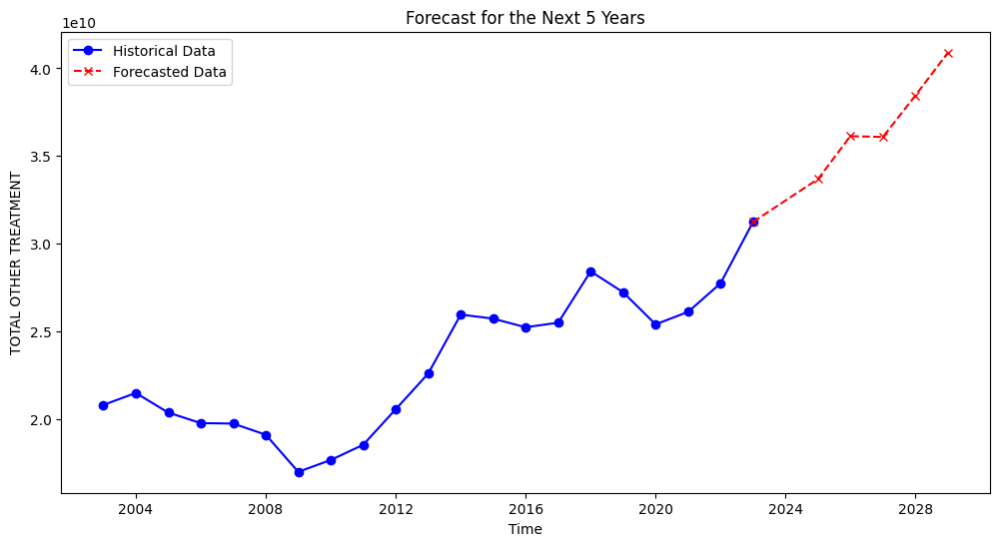

In [81]:
historical_df = time_series_data['TOTAL OTHER TREATMENT'].dropna().reset_index()
historical_df.columns = ['YEAR', 'ACTUAL']
# Display forecasted values
future_years = pd.date_range(start=time_series_data['TOTAL OTHER TREATMENT'].dropna().index[-1] + pd.DateOffset(years=1), periods=5, freq='Y')
forecast_df = pd.DataFrame({'YEAR': future_years, 'FORECAST': forecast_original_scale})
print(forecast_df)

plt.figure(figsize=(12, 6))
# Plot historical data
plt.plot(historical_df['YEAR'], historical_df['ACTUAL'], label='Historical Data', marker='o', color='blue')

# Plot forecasted data
plt.plot([historical_df['YEAR'].iloc[-1]] + forecast_df['YEAR'].tolist(), 
         [historical_df['ACTUAL'].iloc[-1]] + forecast_df['FORECAST'].tolist(), 
         label='Forecasted Data', marker='x', linestyle='--', color='red')

plt.title('Forecast for the Next 5 Years')
plt.xlabel('Time')
plt.ylabel('TOTAL OTHER TREATMENT')
plt.legend()
plt.show()

In [82]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0]
}

grid_search = GridSearchCV(
    estimator=XGBRegressor(objective="reg:squarederror"),
    param_grid=param_grid,
    scoring='neg_mean_squared_error',
    cv=3,
    verbose=1
)

grid_search.fit(X_train, y_train)
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 108 candidates, totalling 324 fits
Best Parameters: {'colsample_bytree': 0.8, 'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 50, 'subsample': 0.8}


In [83]:
time_series_data['TOTAL OTHER TREATMENT']

YEAR
2003-01-01    2.082006e+10
2004-01-01    2.150193e+10
2005-01-01    2.038164e+10
2006-01-01    1.978378e+10
2007-01-01    1.975672e+10
2008-01-01    1.912316e+10
2009-01-01    1.700656e+10
2010-01-01    1.768271e+10
2011-01-01    1.854835e+10
2012-01-01    2.057344e+10
2013-01-01    2.260975e+10
2014-01-01    2.596807e+10
2015-01-01    2.573684e+10
2016-01-01    2.524564e+10
2017-01-01    2.550476e+10
2018-01-01    2.843077e+10
2019-01-01    2.724179e+10
2020-01-01    2.541154e+10
2021-01-01    2.612259e+10
2022-01-01    2.775309e+10
2023-01-01    3.124608e+10
Name: TOTAL OTHER TREATMENT, dtype: float64

In [84]:
from sklearn.model_selection import GridSearchCV
from lightgbm import LGBMRegressor

# Define the parameter grid
param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'num_leaves': [20, 31, 50],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0]
}

# Grid search for hyperparameter tuning
grid_search = GridSearchCV(
    estimator=LGBMRegressor(random_state=42),
    param_grid=param_grid,
    scoring='neg_mean_squared_error',
    cv=3,  # 3-fold cross-validation
    verbose=1
)

grid_search.fit(X_train, y_train)
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 324 candidates, totalling 972 fits
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 8, number of used features: 0
[LightGBM] [Info] Start training from score 1126044822.000000
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warnin

In [85]:
from lightgbm import LGBMRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import pandas as pd
import numpy as np

# Prepare lagged features
def create_lag_features(data, lag=1):
    """
    Create lagged features for a time series dataset.
    """
    df = pd.DataFrame(data)
    for i in range(1, lag + 1):
        df[f'lag_{i}'] = df[0].shift(i)
    df = df.dropna()
    return df

# Lag settings
lag = 3  # Use the last 3 values to predict the next one
data_lagged = create_lag_features(time_series_data['TOTAL OTHER TREATMENT_DIFF'].values, lag)
X = data_lagged.iloc[:, 1:].values  # Lagged features
y = data_lagged.iloc[:, 0].values  # Target variable

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Hyperparameter tuning for LightGBM
best_rmse_lgb = float('inf')
best_maep_lgb = float('inf')
best_lgb_params = None
best_y_test = best_y_pred = 0

# Hyperparameter grid
learning_rates = [0.01, 0.1, 0.2]
max_depths = [3, 5, 7, 9]
n_estimators = [50, 100, 200]
num_leaves = [20, 31, 50, 100, 150, 200]
subsample = [0.8, 1.0]
colsample_bytree = [0.8, 1.0]

for lr in learning_rates:
    for depth in max_depths:
        for n in n_estimators:
            for leaves in num_leaves:
                for sample in subsample:
                    for colsample in colsample_bytree:
                        try:
                            # Train LightGBM model
                            model = LGBMRegressor(
                                learning_rate=lr, 
                                max_depth=depth, 
                                n_estimators=n, 
                                objective='regression',
                                num_leaves = leaves,
                                subsample=sample,
                                colsample_bytree = colsample,
                                random_state=42
                            )
                            model.fit(X_train, y_train)

                            # Predict on test set
                            y_pred = model.predict(X_test)
                            rmse = np.sqrt(mean_squared_error(y_test, y_pred))
                            maep = error_percentage(y_test, y_pred)

                            # Update best RMSE and parameters
                            if rmse < best_rmse_lgb:
                                best_rmse_lgb = rmse
                                best_maep_lgb = maep
                                best_y_test = y_test
                                best_y_pred = y_pred
                                best_lgb_params = (lr, depth, n, leaves, sample, colsample)

                        except Exception as e:
                            print(f"Error with LightGBM params (lr={lr}, depth={depth}, n_estimators={n}): {e}")
                            continue

print(f"Best LightGBM model with RMSE: {best_rmse_lgb}, MAEP: {best_maep_lgb} and parameters: {best_lgb_params}")


[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 13, number of used features: 0
[LightGBM] [Info] Start training from score 651332992.000000
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet 

In [86]:
# Forecast future values
last_lag = time_series_data['TOTAL OTHER TREATMENT_DIFF'].values[-lag:]  # Last 'lag' values
model = LGBMRegressor(learning_rate=best_lgb_params[0], max_depth=best_lgb_params[1], n_estimators=best_lgb_params[2], 
                      objective='regression', num_leaves = best_lgb_params[3], subsample=best_lgb_params[4],
                      colsample_bytree = best_lgb_params[5], random_state=42)
model.fit(X_train, y_train)
# print(last_lag)
future_forecasts = []
for _ in range(5):  # Forecast 5 future values
    input_data = last_lag[-lag:].reshape(1, -1)
    # print(input_data)
    prediction = model.predict(input_data)[0]
    future_forecasts.append(prediction)
    last_lag = np.append(last_lag, prediction)

print("Forecasted values for next 5 years:", future_forecasts)

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 13, number of used features: 0
[LightGBM] [Info] Start training from score 651332992.000000
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet 

In [87]:
# Inverse the differencing to return to the original scale
last_value = time_series_data['TOTAL OTHER TREATMENT'].iloc[-1]
forecast_original_scale = np.array(future_forecasts).cumsum() + last_value  
forecast_original_scale

array([3.18974113e+10, 3.25487443e+10, 3.32000773e+10, 3.38514103e+10,
       3.45027433e+10])

        YEAR      FORECAST
0 2024-12-31  3.189741e+10
1 2025-12-31  3.254874e+10
2 2026-12-31  3.320008e+10
3 2027-12-31  3.385141e+10
4 2028-12-31  3.450274e+10


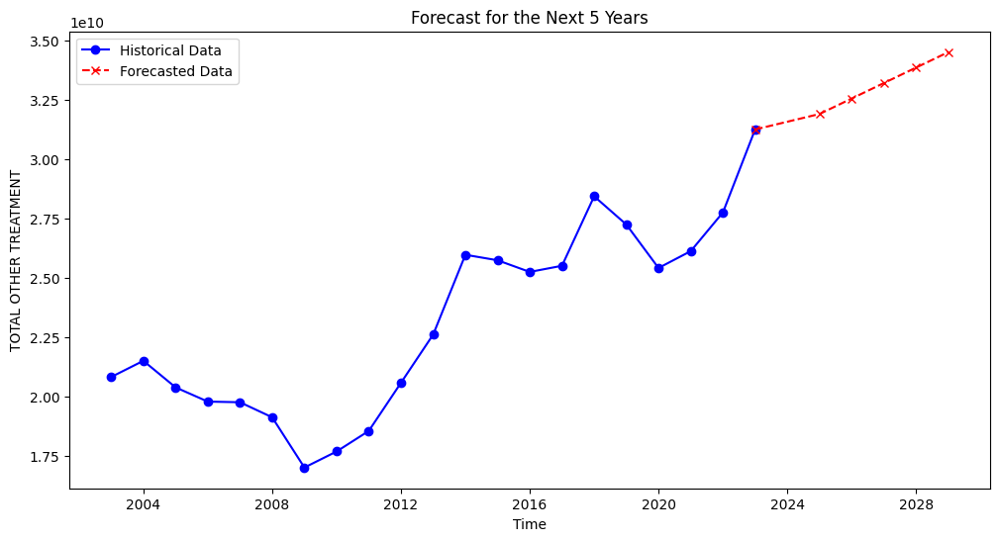

In [88]:
historical_df = time_series_data['TOTAL OTHER TREATMENT'].dropna().reset_index()
historical_df.columns = ['YEAR', 'ACTUAL']
# Display forecasted values
future_years = pd.date_range(start=time_series_data['TOTAL OTHER TREATMENT'].dropna().index[-1] + pd.DateOffset(years=1), periods=5, freq='Y')
forecast_df = pd.DataFrame({'YEAR': future_years, 'FORECAST': forecast_original_scale})
print(forecast_df)

plt.figure(figsize=(12, 6))
# Plot historical data
plt.plot(historical_df['YEAR'], historical_df['ACTUAL'], label='Historical Data', marker='o', color='blue')

# Plot forecasted data
plt.plot([historical_df['YEAR'].iloc[-1]] + forecast_df['YEAR'].tolist(), 
         [historical_df['ACTUAL'].iloc[-1]] + forecast_df['FORECAST'].tolist(), 
         label='Forecasted Data', marker='x', linestyle='--', color='red')

plt.title('Forecast for the Next 5 Years')
plt.xlabel('Time')
plt.ylabel('TOTAL OTHER TREATMENT')
plt.legend()
plt.show()

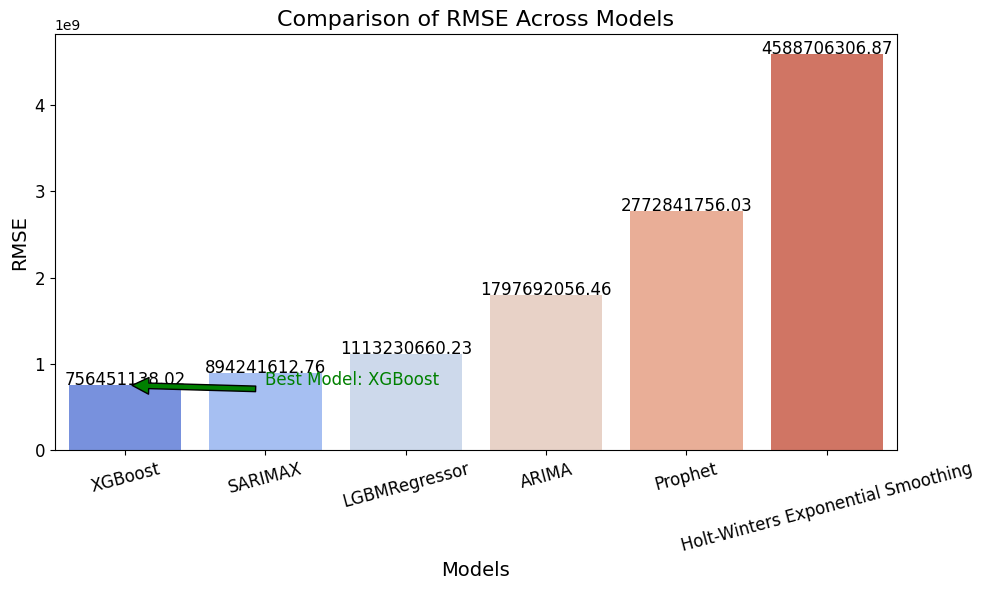

In [89]:
# RMSE values for each model
models = ['SARIMAX', 'ARIMA', 'Holt-Winters Exponential Smoothing', 'Prophet', 'XGBoost', 'LGBMRegressor']
rmse_values = [best_rmse_SARIMA, best_rmse_ARIMA, best_rmse_hw, best_rmse_prophet, best_rmse_xgb, best_rmse_lgb]  # Replace with your actual RMSE values

# Convert to a dictionary for better readability
model_rmse = dict(zip(models, rmse_values))

# Sort models by RMSE (optional)
sorted_model_rmse = {k: v for k, v in sorted(model_rmse.items(), key=lambda item: item[1])}

# Visualization
plt.figure(figsize=(10, 6))
sns.barplot(x=list(sorted_model_rmse.keys()), y=list(sorted_model_rmse.values()), palette="coolwarm")

# Add RMSE values on top of the bars
for i, v in enumerate(sorted_model_rmse.values()):
    plt.text(i, v + 0.2, f"{v:.2f}", ha='center', fontsize=12, color='black')

# Customize the plot
plt.title('Comparison of RMSE Across Models', fontsize=16)
plt.ylabel('RMSE', fontsize=14)
plt.xlabel('Models', fontsize=14)
plt.xticks(rotation=15, fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()

# Highlight the best model (lowest RMSE)
best_model = min(sorted_model_rmse, key=sorted_model_rmse.get)
plt.annotate(f'Best Model: {best_model}', 
             xy=(list(sorted_model_rmse.keys()).index(best_model), sorted_model_rmse[best_model]), 
             xytext=(1, sorted_model_rmse[best_model] + 1), 
             arrowprops=dict(facecolor='green', shrink=0.05), fontsize=12, color='green')

plt.show()
